In [1]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import datetime
import os

#Process mining libraries
import pm4py
import numpy as np
from pm4py.objects.log.util import dataframe_utils
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.algo.filtering.log.timestamp import timestamp_filter



In [2]:
# Import a dataset
dataset = pd.read_csv("OPCUA_dataset_Preprocessing_4.csv")
dataset['concept:name'].value_counts()

StartRawConnection_100.0_0    74012
Attribute_100.0_1             33441
Attribute_100.0_0                55
Session_0.0_1                    34
SecureChannel_100.0_1            26
Attribute_0.0_1                  19
StartRawConnection_0.0_1         17
SecureChannel_0.0_1              17
SecureChannel_100.0_0            12
Name: concept:name, dtype: int64

In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 107633 entries, 0 to 107632
Data columns (total 25 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   flags                        107633 non-null  int64  
 1   pktTotalCount                107633 non-null  int64  
 2   octetTotalCount              107633 non-null  int64  
 3   avg_ps                       107633 non-null  float64
 4   service_errors               107633 non-null  int64  
 5   status_errors                107633 non-null  int64  
 6   msg_size                     107633 non-null  int64  
 7   min_msg_size                 107633 non-null  int64  
 8   time:timestamp               107633 non-null  object 
 9   flowDuration                 107633 non-null  float64
 10  avg_flowDuration             107633 non-null  float64
 11  flowInterval                 107633 non-null  float64
 12  count                        107633 non-null  int64  
 13 

In [3]:
dataset.tail(2)

,flags,pktTotalCount,octetTotalCount,avg_ps,service_errors,status_errors,msg_size,min_msg_size,time:timestamp,flowDuration,...,dst_host_same_src_port_rate,f_pktTotalCount,f_octetTotalCount,f_rate,b_pktTotalCount,b_octetTotalCount,label,multi_label,case:concept:name,concept:name
107631,1,2,359,179.5,0,0,227,96,2020-03-10 17:44:11.678273792,0.007900,...,100.0,1,197,1.970000e+19,1,162,0,Normal,192.168.1.22_60560_192.168.1.20_4840,Attribute_100.0_1
107632,1,2,359,179.5,0,0,227,96,2020-03-10 17:44:11.678492416,0.007685,...,100.0,1,197,1.970000e+19,1,162,0,Normal,192.168.1.22_48970_192.168.1.21_4840,Attribute_100.0_1


In [4]:
from pm4py.objects.log.util import dataframe_utils
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.algo.filtering.log.timestamp import timestamp_filter

log_csv = pd.read_csv(("OPCUA_dataset_Preprocessing_4.csv"), sep = ',')

log_csv = dataframe_utils.convert_timestamp_columns_in_df(log_csv)
log_csv = log_csv.sort_values('time:timestamp')
event_log = log_converter.apply(log_csv)

In [6]:
#print all activities name and number of events
from pm4py.algo.filtering.log.attributes import attributes_filter as log_attributes_filter
activities = log_attributes_filter.get_attribute_values(event_log, "concept:name")
print(activities)

{'StartRawConnection_0.0_1': 17, 'SecureChannel_0.0_1': 17, 'Session_0.0_1': 34, 'Attribute_0.0_1': 19, 'Attribute_100.0_1': 33441, 'SecureChannel_100.0_1': 26, 'Attribute_100.0_0': 55, 'SecureChannel_100.0_0': 12, 'StartRawConnection_100.0_0': 74012}


In [7]:
#print start activities / end activities and number of case id
start_activities = pm4py.get_start_activities(event_log)
end_activities = pm4py.get_end_activities(event_log)

print("Start activities:{}\nEnd activities:{}".format(start_activities,end_activities))


Start activities:{'StartRawConnection_0.0_1': 16, 'SecureChannel_100.0_0': 9, 'StartRawConnection_100.0_0': 74012, 'Attribute_100.0_0': 49}
End activities:{'Attribute_100.0_1': 12, 'SecureChannel_100.0_1': 3, 'SecureChannel_100.0_0': 10, 'StartRawConnection_100.0_0': 74012, 'Attribute_100.0_0': 49}


/var/folders/v6/jrh7dpmj4rn6h4bw6xqfx5n40000gn/T/ipykernel_24071/4004185987.py:5: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  gviz = pn_visualizer.apply(net, initial_marking, final_marking)


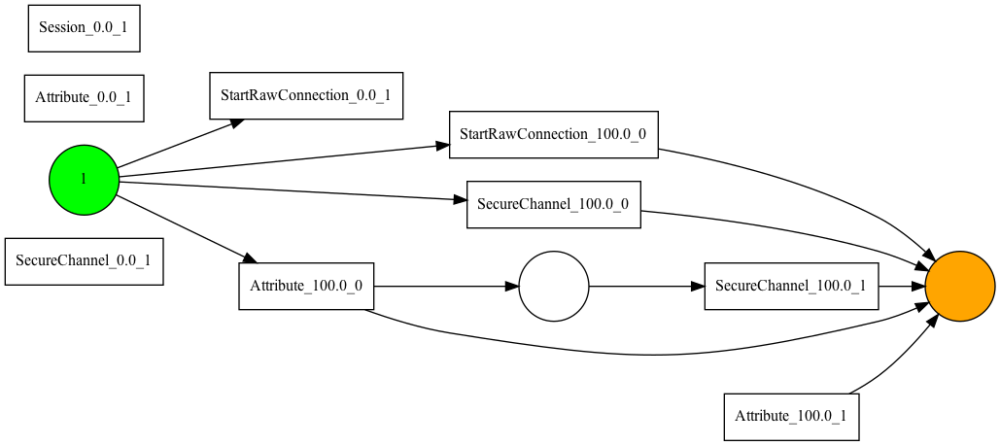

In [23]:
#Alpha Miner
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
net, initial_marking, final_marking = alpha_miner.apply(event_log)
from pm4py.visualization.petrinet import visualizer as pn_visualizer
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

/Users/pmarincola/opt/anaconda3/envs/pm4pyEnv1/lib/python3.9/site-packages/pm4py/objects/petri/__init__.py:19: UserWarning: please use the pm4py.objects.petri_net package instead.
  warnings.warn('please use the pm4py.objects.petri_net package instead.')
/Users/pmarincola/opt/anaconda3/envs/pm4pyEnv1/lib/python3.9/site-packages/pm4py/objects/petri/obj.py:19: UserWarning: pm4py.objects.petri.obj is deprecated. Please use the class pm4py.objects.petri_net.obj instead.
  warnings.warn("pm4py.objects.petri.obj is deprecated. Please use the class pm4py.objects.petri_net.obj instead.")
/Users/pmarincola/opt/anaconda3/envs/pm4pyEnv1/lib/python3.9/site-packages/pm4py/objects/petri/exporter/__init__.py:21: UserWarning: please use the pm4py.objects.petri_net.exporter package instead.
  warnings.warn('please use the pm4py.objects.petri_net.exporter package instead.')
/Users/pmarincola/opt/anaconda3/envs/pm4pyEnv1/lib/python3.9/site-packages/pm4py/objects/petri/importer/__init__.py:21: UserWarning

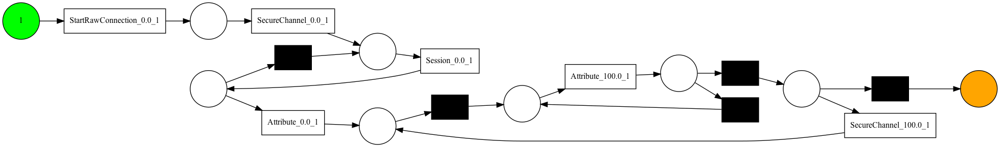

In [5]:
# creating an empty Petri net
#MOdello OK
from pm4py.objects.petri.petrinet import PetriNet, Marking
net = PetriNet("new_petri_net")
# creating 
start_StartRawConection = PetriNet.Place("Start_StartRawConection_0.0_1")
startRawConection_SecureChannel = PetriNet.Place("StartRawConection_SecureChannel_0.0_1")
secureChannel_Session = PetriNet.Place("SecureChannel_Session_0.0_1")
#session_Session = PetriNet.Place("Session_Session_0.0_1")
session_Attribute = PetriNet.Place("Session_Attribute_0.0_1")
attribute_Attribute = PetriNet.Place("attribute_Attribute_100.0_1")
attribute_SecureChannel = PetriNet.Place("attribute_SecureChannel_100.0_1")
attribute_end = PetriNet.Place("attribute_end")

hidden_attribute100 = PetriNet.Place("hidden_attribute100")
hidden_securechannel100 = PetriNet.Place("hidden_securechannel100")

# add the places to the Petri Net
net.places.add(start_StartRawConection)
net.places.add(startRawConection_SecureChannel)
net.places.add(secureChannel_Session)
#net.places.add(session_Session)
net.places.add(session_Attribute)
net.places.add(attribute_Attribute)
net.places.add(attribute_SecureChannel)
net.places.add(hidden_attribute100)
net.places.add(hidden_securechannel100)
net.places.add(attribute_end)


# Create transitions
t_1 = PetriNet.Transition("p1", "StartRawConnection_0.0_1")
t_2 = PetriNet.Transition("p2", "SecureChannel_0.0_1")
t_3 = PetriNet.Transition("p3", "Session_0.0_1")
t_4 = PetriNet.Transition("p4", "Attribute_0.0_1")
t_5 = PetriNet.Transition("p5", "Attribute_100.0_1")
t_6 = PetriNet.Transition("p6", "SecureChannel_100.0_1")

t_7 = PetriNet.Transition("p7", None)
t_8 = PetriNet.Transition("p8", None)
t_9 = PetriNet.Transition("p9", None)
t_10 = PetriNet.Transition("p10", None)
t_11 = PetriNet.Transition("p11", None)

# Add the transitions to the Petri Net
net.transitions.add(t_1)
net.transitions.add(t_2)
net.transitions.add(t_3)
net.transitions.add(t_4)
net.transitions.add(t_5)
net.transitions.add(t_6)
net.transitions.add(t_7)
net.transitions.add(t_8)
net.transitions.add(t_9)
net.transitions.add(t_10)
net.transitions.add(t_11)

# Add arcs
from pm4py.objects.petri import utils
utils.add_arc_from_to(start_StartRawConection, t_1, net)
utils.add_arc_from_to(t_1, startRawConection_SecureChannel, net)
utils.add_arc_from_to(startRawConection_SecureChannel, t_2, net)
utils.add_arc_from_to(t_2, secureChannel_Session, net)
utils.add_arc_from_to(secureChannel_Session, t_3, net)
utils.add_arc_from_to(t_3, session_Attribute, net)

utils.add_arc_from_to(session_Attribute,t_7, net)
utils.add_arc_from_to(t_7,secureChannel_Session, net)

utils.add_arc_from_to(session_Attribute, t_4, net)
utils.add_arc_from_to(t_4, attribute_Attribute, net)

utils.add_arc_from_to(attribute_Attribute,t_8, net)
utils.add_arc_from_to(t_8,hidden_attribute100, net)
utils.add_arc_from_to(hidden_attribute100,t_5, net)
utils.add_arc_from_to(t_5,attribute_SecureChannel, net)

utils.add_arc_from_to(attribute_SecureChannel,t_9, net)
utils.add_arc_from_to(t_9,hidden_attribute100, net)

utils.add_arc_from_to(attribute_SecureChannel,t_10, net)
utils.add_arc_from_to(t_10,hidden_securechannel100, net)

utils.add_arc_from_to(hidden_securechannel100,t_6, net)
utils.add_arc_from_to(t_6,attribute_Attribute, net)
utils.add_arc_from_to(hidden_securechannel100,t_11, net)

utils.add_arc_from_to(t_11,attribute_end, net)


# Adding tokens
initial_marking = Marking()
initial_marking[start_StartRawConection] = 1
final_marking = Marking()
final_marking[attribute_end] = 1


from pm4py.visualization.petrinet import visualizer as pn_visualizer
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)


knownet, initial_marking, final_marking = net, initial_marking, final_marking

In [6]:
#from pm4py.algo.discovery.alpha import algorithm as alpha_miner
#from pm4py.algo.discovery.inductive import algorithm as inductive_miner

#net, initial_marking, final_marking = inductive_miner.apply(event_log)

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
replayed_traces = token_replay.apply(event_log, knownet, initial_marking, final_marking)

replaying log with TBR, completed variants :: 100%|██████████| 15/15 [00:02<00:00,  7.01it/s]


In [13]:
print(replayed_traces[4])

{'trace_is_fit': False, 'trace_fitness': 0.9993544222078761, 'activated_transitions': [StartRawConnection_0.0_1, StartRawConnection_0.0_1, SecureChannel_0.0_1, SecureChannel_0.0_1, Session_0.0_1, Session_0.0_1, p7, Session_0.0_1, p7, Session_0.0_1, Attribute_0.0_1, Attribute_0.0_1, Attribute_0.0_1, Attribute_0.0_1, p8, Attribute_100.0_1, p8, Attribute_100.0_1, p8, Attribute_100.0_1, p8, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_100.0_1, p9, Attribute_10

In [7]:
#conformance checking alignaments
from pm4py.algo.conformance.alignments import algorithm as alignments
aligned_traces = alignments.apply_log(event_log, knownet, initial_marking, final_marking)
print(aligned_traces)

/Users/pmarincola/opt/anaconda3/envs/pm4pyEnv1/lib/python3.9/site-packages/pm4py/algo/conformance/alignments/algorithm.py:19: UserWarning: please use pm4py.algo.conformance.alignments.petri_net.algorithm instead
  warnings.warn("please use pm4py.algo.conformance.alignments.petri_net.algorithm instead")
aligning log, completed variants :: 100%|██████████| 15/15 [28:09<00:00, 112.61s/it] 


[{'alignment': [('StartRawConnection_0.0_1', 'StartRawConnection_0.0_1'), ('SecureChannel_0.0_1', 'SecureChannel_0.0_1'), ('Session_0.0_1', 'Session_0.0_1'), ('>>', None), ('Session_0.0_1', 'Session_0.0_1'), ('Attribute_0.0_1', 'Attribute_0.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1'), ('>>', None), ('Attribute_100.0_1', 'Attribute_100.0_1')

In [12]:
print(aligned_traces[100])

{'alignment': [('StartRawConnection_100.0_0', '>>'), ('>>', 'StartRawConnection_0.0_1'), ('>>', 'SecureChannel_0.0_1'), ('>>', 'Session_0.0_1'), ('>>', 'Attribute_0.0_1'), ('>>', None), ('>>', 'Attribute_100.0_1'), ('>>', None), ('>>', None)], 'cost': 60003, 'visited_states': 9, 'queued_states': 10, 'traversed_arcs': 13, 'lp_solved': 1, 'fitness': 0.0}


In [30]:
# token reply with know Inductive Miner complete dataset
trace_is_fit = 0
trace_fitness = 0
missing_tokens = 0
consumed_tokens = 0
remaining_tokens = 0
produced_tokens = 0

#alignment
cost = 0
visited_states = 0
queued_states = 0
traversed_arcs = 0
lp_solved = 0
fitness_AL = 0

output = []
for rp, al, trace in zip(replayed_traces, aligned_traces, event_log):
    #caseid
    case_id = trace.attributes.get('concept:name')
    #IP Class
    IPclass = int(case_id.split('.')[0])
    
    if IPclass <= 127 :
        IPlabel = 'A'
    elif (IPclass >127) & (IPclass <= 191) :
        IPlabel = 'B'
    elif (IPclass >= 192) :
        IPlabel = 'C'
    
    #trace_is_fit
    if rp['trace_is_fit'] == True :
        trace_is_fit = 1
    else:
        trace_is_fit = 0
    #trace_fitness
    trace_fitness = float(rp['trace_fitness'])
    #missing_tokens
    missing_tokens = rp['missing_tokens']
    #consumed_tokens 
    consumed_tokens = rp['consumed_tokens']
    #remaining_tokens
    remaining_tokens = rp['remaining_tokens']
    #produced_tokens
    produced_tokens = rp['produced_tokens']
    #AL cost
    cost = al['cost']
    #visited_states
    visited_states = al['visited_states']
    #queued_states
    queued_states = al['queued_states']
    # traversed_arcs
    traversed_arcs = al['traversed_arcs']
    #lp_solved
    lp_solved = al['lp_solved']
    #fitness_AL
    fitness_AL = float(al['fitness'])
    
    label = '1'
    tot_flags = 0
    tot_msg_size = 0
    tot_flowDuration = 0
    
    for event in trace:
        multi_label_value = event['multi_label']
        if multi_label_value == 'Impersonation' :
            label = '2'
        elif multi_label_value == 'DoS' :
            label = '3'
        elif multi_label_value == 'MITM' :
            label = '4'
           
        flags = event['flags']
        tot_flags = tot_flags + flags
        msg_size = event['msg_size']
        tot_msg_size = tot_msg_size + msg_size 
        flowDuration = event['flowDuration']
        tot_flowDuration = tot_flowDuration + flowDuration
        
    len_flag = len(trace)
    len_msg = len(trace)
    
    flags_mean = tot_flags/len_flag
    msg_size_mean = tot_msg_size/len_msg
    flowDuration = tot_flowDuration
            
    output.append([case_id, IPlabel,flags_mean,msg_size_mean,flowDuration, trace_is_fit, trace_fitness,missing_tokens,consumed_tokens,
                   remaining_tokens,produced_tokens,cost,visited_states,queued_states,
                   traversed_arcs,lp_solved,fitness_AL,label])
	
df = pd.DataFrame(output, columns=['case_id','IPclass','stat_flags','stat_msg_size','stat_flowDuration', 'trace_is_fit_TR', 'trace_fitness_TR','missing_tokens_TR',
                                   'consumed_tokens_TR','remaining_tokens_TR','produced_tokens_TR','cost_AL',
                                   'visited_states_AL','queued_states_AL','traversed_arcs_AL','lp_solved_AL',
                                   'fitness_AL','label'])

df.to_csv(os.path.join("ML",'OPCUA_dataset_ML.csv'))

In [17]:
#Throughput Time
from pm4py.statistics.traces.generic.log import case_statistics
all_case_durations = case_statistics.get_all_casedurations(event_log, parameters={
    case_statistics.Parameters.TIMESTAMP_KEY: "time:timestamp"})

In [18]:
print(all_case_durations[1000])

0.0


In [19]:
#Case Arrival/Dispersion Ratio
from pm4py.statistics.traces.generic.log import case_arrival
case_arrival_ratio = case_arrival.get_case_arrival_avg(event_log, parameters={
    case_arrival.Parameters.TIMESTAMP_KEY: "time:timestamp"})
from pm4py.statistics.traces.generic.log import case_arrival
case_dispersion_ratio = case_arrival.get_case_dispersion_avg(event_log, parameters={
    case_arrival.Parameters.TIMESTAMP_KEY: "time:timestamp"})



In [20]:
print(case_arrival_ratio)
print(case_dispersion_ratio )

0.08444549220489977
0.09842682397246406


In [21]:
#TEST CORRELATIO MINER
import pandas as pd
from pm4py.objects.log.util import dataframe_utils
df = pd.read_csv("OPCUA_dataset_Preprocessing_4.csv")
df = dataframe_utils.convert_timestamp_columns_in_df(df)
df = df[["concept:name", "time:timestamp"]]

In [22]:
from pm4py.algo.discovery.correlation_mining import algorithm as correlation_miner

frequency_dfg, performance_dfg = correlation_miner.apply(df, parameters={correlation_miner.Variants.CLASSIC.value.Parameters.ACTIVITY_KEY: "concept:name",
                                correlation_miner.Variants.CLASSIC.value.Parameters.TIMESTAMP_KEY: "time:timestamp"})
                                

In [23]:
activities_freq = dict(df["concept:name"].value_counts())

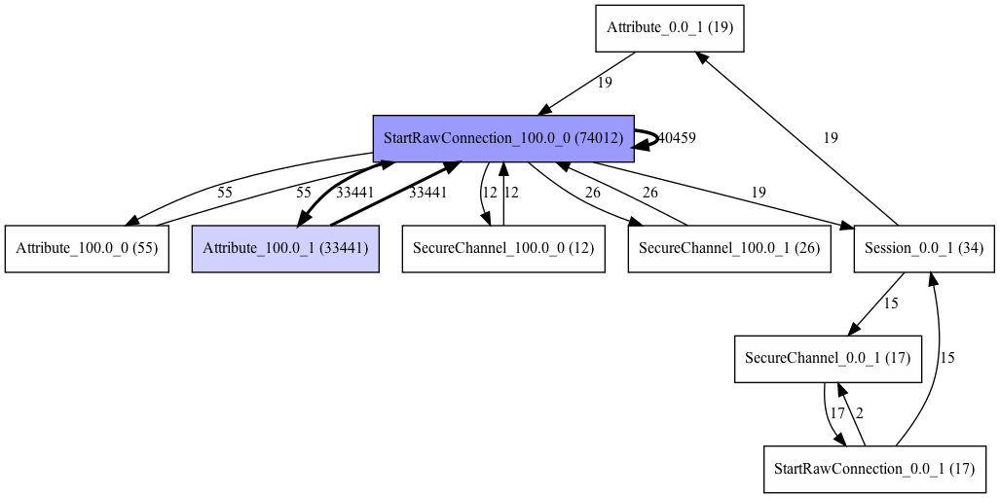

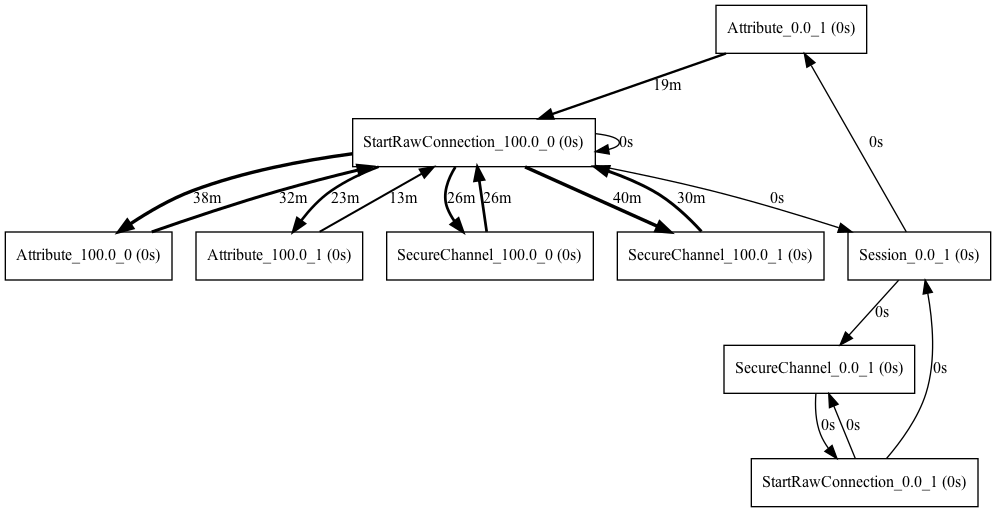

In [24]:
from pm4py.visualization.dfg import visualizer as dfg_visualizer
gviz_freq = dfg_visualizer.apply(frequency_dfg, variant=dfg_visualizer.Variants.FREQUENCY, activities_count=activities_freq, parameters={"format": "png"})
gviz_perf = dfg_visualizer.apply(performance_dfg, variant=dfg_visualizer.Variants.PERFORMANCE, activities_count=activities_freq, parameters={"format": "png"})
dfg_visualizer.view(gviz_freq)
dfg_visualizer.view(gviz_perf)